In [1]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io

from monolayer_tracking.segmented_comprehension import Stack
from monolayer_tracking import preprocessing
from monolayer_tracking.denoise_autoencoder import UNet

from tqdm.notebook import tqdm
from scipy import ndimage
from pathlib import Path
from glob import glob
from natsort import natsorted
import tensorflow as tf
import tensorflow_probability as tfp

# architecture

In [2]:
def get_FUCCI(stack_location):
    # load data
    filepath=Path(stack_location.replace('Segmentation','Data'))

    stage_name=filepath.stem.split('-')[-1]
    img_folder=filepath.parents[1]
    img_path=str(img_folder/('20240312/{img_type}-'+stage_name+'.tif')) # EDITED: 20240312
    pip=io.imread(img_path.format(img_type='PIP'))
    geminin=io.imread(img_path.format(img_type='geminin'))
    pip=pip/np.quantile(pip, 0.99)
    geminin=geminin/np.quantile(geminin, 0.99)
    return denoise_FUCCI(pip, geminin)

def quantile_normalize(item, quantile=0.99):
    return item/tfp.stats.quantiles(item, 100)[-2]

def denoise_FUCCI(pip, geminin, verbose=0):
    # determine necessary reshaping for CNN input
    img_shape=np.array(pip[0].shape)
    model_shape=16*(img_shape//16)

    padding=((img_shape-model_shape)/2).astype('int')

    y_slice=slice(padding[0], padding[0]+model_shape[0])
    x_slice=slice(padding[1], padding[1]+model_shape[1])

    # initialize CNN autoencoder
    full_ae=UNet((*model_shape, 1), filters=32)
    #full_ae.load_weights('FUCCI_denoise/checkpoints/0303-skip_CNN-207-0.0078.hdf5')
    #full_ae.load_weights('tf_checkpoints/FUCCI_denoiser/0305-256_skip_CNN-027-0.0041.hdf5')
    #full_ae.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240316\256_skip_CNN-023-0.0051.hdf5')
    full_ae.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240326\width32_depth10\tile256-047-0.0039.hdf5')

    output=[]
    for img_channel in [geminin, pip]:
        # ae denoise
        data=tf.data.Dataset.from_tensor_slices(img_channel[:,y_slice,x_slice,np.newaxis]).batch(1).prefetch(1)
        prediction=full_ae.predict(data, verbose=verbose)

        # pad edges to original image shape
        repadding=np.array([padding, img_shape-(model_shape+padding)]).T
        output.append(np.pad(prediction[...,0], ((0,0),*repadding), mode='edge'))

    return output

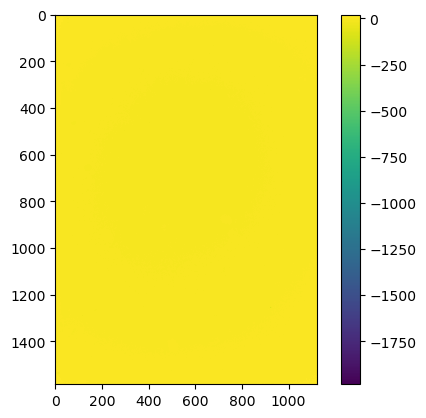

In [4]:
img=io.imread(root_dir+gem_fmt.format(stage=40, timepoint=1)).astype(int)
plt.imshow(img-gem_bg)
plt.colorbar()

In [5]:
gem_bg

array([[83.640625 , 82.0625   , 81.2734375, ..., 89.1640625, 87.5859375,
        89.1640625],
       [82.8515625, 82.8515625, 84.4296875, ..., 89.1640625, 86.796875 ,
        87.5859375],
       [82.8515625, 84.4296875, 84.4296875, ..., 86.0078125, 86.796875 ,
        87.5859375],
       ...,
       [82.8515625, 82.0625   , 82.8515625, ..., 85.21875  , 83.640625 ,
        85.21875  ],
       [83.640625 , 84.4296875, 80.484375 , ..., 87.5859375, 85.21875  ,
        83.640625 ],
       [82.8515625, 82.8515625, 81.2734375, ..., 82.8515625, 83.640625 ,
        87.5859375]])

(array([1.58000e+02, 4.86000e+02, 1.75000e+03, 4.66700e+03, 1.01920e+04,
        2.05060e+04, 3.62980e+04, 5.75660e+04, 8.66470e+04, 1.10474e+05,
        1.47162e+05, 1.61859e+05, 1.78594e+05, 1.83256e+05, 1.68768e+05,
        1.58195e+05, 1.33957e+05, 1.04362e+05, 7.73840e+04, 4.91010e+04,
        3.71630e+04, 2.01120e+04, 1.18570e+04, 6.19700e+03, 3.32800e+03,
        1.76400e+03, 8.96000e+02, 4.86000e+02, 2.28000e+02, 1.57000e+02]),
 array([1.  , 1.05, 1.1 , 1.15, 1.2 , 1.25, 1.3 , 1.35, 1.4 , 1.45, 1.5 ,
        1.55, 1.6 , 1.65, 1.7 , 1.75, 1.8 , 1.85, 1.9 , 1.95, 2.  , 2.05,
        2.1 , 2.15, 2.2 , 2.25, 2.3 , 2.35, 2.4 , 2.45, 2.5 ]),
 [<matplotlib.patches.Polygon at 0x231fa5e5cd0>])

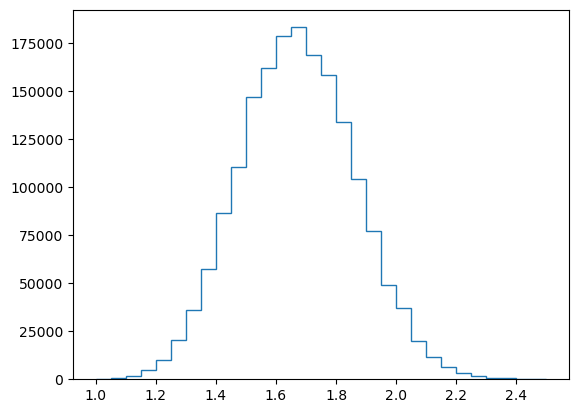

In [32]:
plt.hist((PIP_bglong/pip_bg).flatten(), bins=30, range=(1,2.5), histtype='step')

In [6]:
pip_bg=io.imread(root_dir+'20240331_bg_w1491zyla.TIF')
gem_bg=io.imread(root_dir+'20240331_bg_w2561zyla.TIF')
gem_bglong=io.imread(root_dir+'20240331_bg_w5561zyla.TIF')
pip_bglong=io.imread(root_dir+'20240331_bg_w4491zyla.TIF')

(array([1.774071e+06, 6.000000e+00, 0.000000e+00, 0.000000e+00,
        0.000000e+00, 1.000000e+00, 0.000000e+00, 1.000000e+00,
        0.000000e+00, 1.000000e+00]),
 array([ 102. ,  362.2,  622.4,  882.6, 1142.8, 1403. , 1663.2, 1923.4,
        2183.6, 2443.8, 2704. ]),
 <BarContainer object of 10 artists>)

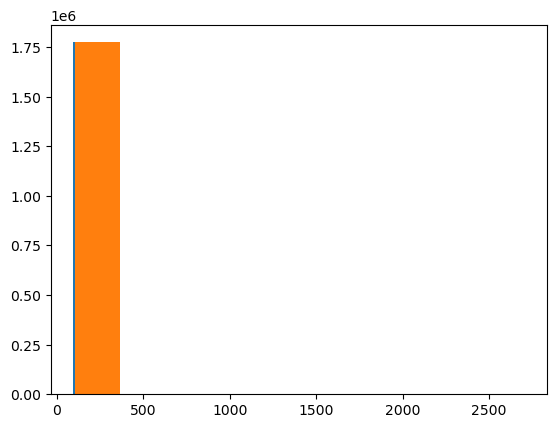

In [7]:
plt.hist(gem_bg.flatten())
plt.hist(gem_bglong.flatten())

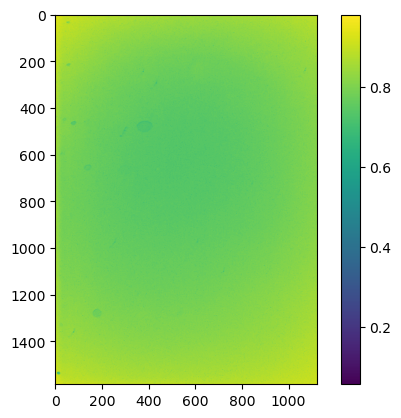

In [8]:
plt.imshow(gem_bg/gem_bglong)
plt.colorbar()

In [ ]:
root_dir=r'F:\my_data\raw_data\F:\my_data\raw_data\20240331 FUCCI halo colonies/'
gem_fmt='20240331_w2561zyla_s{stage}_t{timepoint}.TIF'
pip_fmt='20240331_w1491zyla_s{stage}_t{timepoint}.TIF'
timepoints=39
stages=246
output_dir=Path(r'F:\my_data\Data\20240331 FUCCI halo colonies/denoised/')
output_dir.mkdir(exist_ok=True, parents=True)

pip_bg=io.imread(root_dir+'20240331_bg_w1491zyla.TIF')
gem_bg=io.imread(root_dir+'20240331_bg_w2561zyla.TIF')

#gem_bglong=io.imread(root_dir+'20240331_bg_w5561zyla.TIF')
#pip_bglong=io.imread(root_dir+'20240331_bg_w4491zyla.TIF')

#pip_bg=pip_bglong*np.median(pip_bg/pip_bglong)
#gem_bg=gem_bglong*np.median(gem_bg/gem_bglong)

for timepoint in tqdm(range(1,timepoints+1)):
    geminin=[]
    pip=[]
    for stage in range(1,stages+1):
        geminin.append(io.imread(root_dir+gem_fmt.format(stage=stage, timepoint=timepoint)).astype(int)-gem_bg)
        pip.append(io.imread(root_dir+pip_fmt.format(stage=stage, timepoint=timepoint)).astype(int)-pip_bg)
    geminin=np.array(geminin)
    pip=np.array(pip)

    geminin=np.array(geminin)/np.quantile(geminin,0.99)
    pip=np.array(pip)/np.quantile(pip,0.99)

    geminin_denoised, pip_denoised=denoise_FUCCI(pip, geminin, verbose=1)

    geminin_denoised=(preprocessing.normalize(geminin_denoised, quantile=(0.01,0.99))*255).astype('uint8')
    pip_denoised=(preprocessing.normalize(pip_denoised, quantile=(0.01,0.99))*255).astype('uint8')

    io.imsave(output_dir/f'geminin_{timepoint}.tif', geminin_denoised)
    io.imsave(output_dir/f'PIP_{timepoint}.tif', pip_denoised)

In [ ]:
# export time stacks
pip_outputdir=Path(r'F:\my_data\Data\20240331 FUCCI halo colonies\tiles\pip_denoised/')
gem_outputdir=Path(r'F:\my_data\Data\20240331 FUCCI halo colonies\tiles\geminin_denoised/')

pip_outputdir.mkdir(exist_ok=True)
gem_outputdir.mkdir(exist_ok=True)

for stage in tqdm(range(stages)):
    pip=[]
    gem=[]
    for timepoint in tqdm(range(1,timepoints+1), leave=False):
        gem.append(io.imread(output_dir/f'geminin_{timepoint}.tif')[stage])
        pip.append(io.imread(output_dir/f'PIP_{timepoint}.tif')[stage])
    
    io.imsave(gem_outputdir/f'tile_{stage+1}.tif', np.array(gem))
    io.imsave(pip_outputdir/f'tile_{stage+1}.tif', np.array(pip))

In [14]:
# export individual images
pip_outputdir=Path(r'F:\my_data\Data\20240331 FUCCI halo colonies\tiles\pip_denoised/')
gem_outputdir=Path(r'F:\my_data\Data\20240331 FUCCI halo colonies\tiles\geminin_denoised/')

for timepoint in tqdm(range(1, timepoints+1), leave=False):
    pip=io.imread(output_dir/f'PIP_{timepoint}.tif')
    gem=io.imread(output_dir/f'geminin_{timepoint}.tif')

    for n, (pip_img, gem_img) in enumerate(zip(pip, gem)):
        io.imsave(pip_outputdir/f'PIP_s{n+1}_t{timepoint}.tif', pip_img)
        io.imsave(gem_outputdir/f'geminin_s{n+1}_t{timepoint}.tif', gem_img)

  0%|          | 0/39 [00:00<?, ?it/s]

C:\Users\Andy\AppData\Local\Temp\ipykernel_7500\4168814961.py:10: UserWarning: F:\my_data\Data\20240331 FUCCI halo colonies\tiles\pip_denoised\PIP_s240_t32.tif is a low contrast image
  io.imsave(pip_outputdir/f'PIP_s{n+1}_t{timepoint}.tif', pip_img)
C:\Users\Andy\AppData\Local\Temp\ipykernel_7500\4168814961.py:10: UserWarning: F:\my_data\Data\20240331 FUCCI halo colonies\tiles\pip_denoised\PIP_s242_t32.tif is a low contrast image
  io.imsave(pip_outputdir/f'PIP_s{n+1}_t{timepoint}.tif', pip_img)
C:\Users\Andy\AppData\Local\Temp\ipykernel_7500\4168814961.py:10: UserWarning: F:\my_data\Data\20240331 FUCCI halo colonies\tiles\pip_denoised\PIP_s9_t33.tif is a low contrast image
  io.imsave(pip_outputdir/f'PIP_s{n+1}_t{timepoint}.tif', pip_img)
C:\Users\Andy\AppData\Local\Temp\ipykernel_7500\4168814961.py:10: UserWarning: F:\my_data\Data\20240331 FUCCI halo colonies\tiles\pip_denoised\PIP_s12_t33.tif is a low contrast image
  io.imsave(pip_outputdir/f'PIP_s{n+1}_t{timepoint}.tif', pip_img)

In [39]:
output_dir.mkdir(exist_ok=True)

In [40]:
io.imsave(output_dir/f'geminin_{timepoint}.tif', geminin_denoised)
io.imsave(output_dir/f'PIP_{timepoint}.tif', pip_denoised)

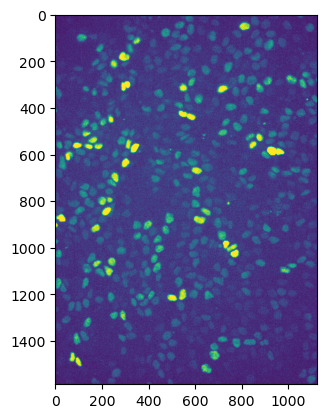

In [18]:
plt.imshow(preprocessing.normalize(geminin[20], quantile=(0.01,0.99)))

In [19]:
img_shape=np.array(pip[0].shape)
model_shape=16*(img_shape//16)

padding=((img_shape-model_shape)/2).astype('int')

y_slice=slice(padding[0], padding[0]+model_shape[0])
x_slice=slice(padding[1], padding[1]+model_shape[1])

# initialize CNN autoencoder
full_ae=UNet((*model_shape, 1), filters=32)
#full_ae.load_weights('FUCCI_denoise/checkpoints/0303-skip_CNN-207-0.0078.hdf5')
#full_ae.load_weights('tf_checkpoints/FUCCI_denoiser/0305-256_skip_CNN-027-0.0041.hdf5')
#full_ae.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240316\256_skip_CNN-023-0.0051.hdf5')
full_ae.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240326\width32_depth10\tile256-047-0.0039.hdf5')

In [21]:
import tensorflow as tf

In [22]:
data=tf.data.Dataset.from_tensor_slices(pip[:,y_slice,x_slice,np.newaxis])

In [26]:
out=full_ae.predict(data.batch(2))

24/24 [==============================] - 52s 463ms/step


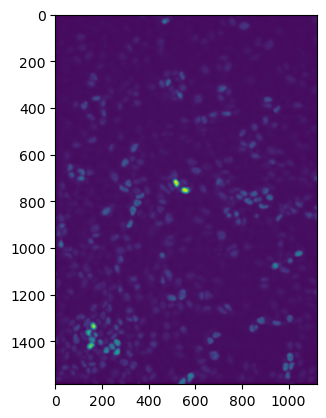

In [27]:
plt.imshow(out[20])

In [5]:
# break images into 512x512 overlapping patches
def pad_to_shape(img, shape):
    # pad bottom and right to the desired shape
    y_pad=shape[0]-img.shape[0]
    x_pad=shape[1]-img.shape[1]
    return np.pad(img, ((0,y_pad),(0,x_pad)), mode='edge')

def get_tiles(img, tile_size=512):
    y_blocks, x_blocks=np.array(img.shape[-2:])//tile_size+1

    # compute overlap size
    overlap_y, overlap_x=(tile_size-(np.array(img.shape[-2:])%tile_size))//[y_blocks-1, x_blocks-1]
    # get tiles
    tiles=[]
    for y in range(y_blocks):
        for x in range(x_blocks):
            y_start=y*(tile_size-overlap_y)
            y_end=y_start+tile_size
            x_start=x*(tile_size-overlap_x)
            x_end=x_start+tile_size
            tiles.append(pad_to_shape(img[y_start:y_end, x_start:x_end], (tile_size, tile_size)))
    return np.array(tiles)

def stitch_tiles(tiles, output_shape):
    # get number of rows and columns
    tile_size=tiles.shape[-1]
    rows, cols=np.array(output_shape)//tile_size+1

    # initialize output array
    output=np.zeros((rows*tile_size, cols*tile_size))

    # compute overlap size
    overlap_y, overlap_x=(tile_size-(np.array(output_shape)%tile_size))//[rows-1, cols-1]

    # stitch tiles with feathered averaging of overlaps
    for y in range(rows):
        for x in range(cols):
            y_start=y*(tile_size-overlap_y)
            y_end=y_start+tile_size
            x_start=x*(tile_size-overlap_x)
            x_end=x_start+tile_size
            output[y_start:y_end, x_start:x_end]+=tiles[y*cols+x]
    
    for x in range(1,cols):
        x_start=x*(tile_size-overlap_x)
        x_end=x_start+overlap_x
        output[:,x_start:x_end]/=2

    for y in range(1,rows):
        y_start=y*(tile_size-overlap_y)
        y_end=y_start+overlap_y
        output[y_start:y_end,:]/=2
    
    return output[0:output_shape[0], 0:output_shape[1]]

In [34]:
def get_FUCCI_tiles(stack_location, norm_quantile=0.99, tile_size=256):
    # load data
    filepath=Path(stack_location.replace('Segmentation','Data'))

    stage_name=filepath.stem.split('-')[-1]
    img_folder=filepath.parents[1]
    img_path=str(img_folder/('{img_type}-'+stage_name+'.tif')) # EDITED: 20240312
    pip=io.imread(img_path.format(img_type='PIP'))
    geminin=io.imread(img_path.format(img_type='geminin'))

    pip=pip/np.quantile(pip, norm_quantile)
    geminin=geminin/np.quantile(geminin, norm_quantile)

    # initialize CNN autoencoder
    tile_ae=AutoEncoder((tile_size, tile_size, 1))
    tile_ae.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240317-0228_and_0316\skip_CNN256-044-0.0020.hdf5')

    # determine necessary reshaping for CNN input
    img_shape=np.array(pip[0].shape)
    rows, cols=np.array(img_shape[-2:])//tile_size+1

    output=[]
    for img_channel in [geminin, pip]:
        # get tiled images
        channel_tiles=np.array([get_tiles(img, tile_size) for img in img_channel]).reshape(-1,tile_size,tile_size,1)

        # ae denoise
        prediction=tile_ae.predict(channel_tiles, batch_size=4)

        # stitch tiles
        output.append(np.array([stitch_tiles(tiles, img_shape) for tiles in prediction.reshape(-1,rows*cols,tile_size,tile_size)]))

    return np.array(output)

# preprocess

## run denoiser

In [9]:
from natsort import natsorted
from glob import glob

stack_paths=natsorted(glob('F:/my_data/Segmentation/20240311 FUCCI halo sorted col_glass high_density/segmented/*/'))

In [10]:
for stack_path in tqdm(stack_paths):
    stack=Stack(stack_path)
    # if any frame in stack.frames doesn't have a .FUCCI attribute, then run the following code
    #if not all([hasattr(frame, 'FUCCI') for frame in stack.frames]):
    output=np.array(get_FUCCI(stack_path))

    # normalize
    for channel in output:
        channel[:]=preprocessing.normalize(channel, quantile=(0,0.99))

    # convert to 8-bit
    output=(output*255).astype('uint8')

    # reshape for each frame
    output=output.swapaxes(0,1)

    for frame, FUCCI_data in zip(stack.frames[:132], output):
        frame.FUCCI=FUCCI_data
        frame.to_seg_npy(frame.name)

  0%|          | 0/20 [00:00<?, ?it/s]

In [12]:
for stack_path in tqdm(stack_paths):
    stack=Stack(stack_path)
    # if any frame in stack.frames doesn't have a .FUCCI attribute, then run the following code
    #if not all([hasattr(frame, 'FUCCI') for frame in stack.frames]):
    output=np.array(get_FUCCI(stack_path))

    # normalize
    for channel in output:
        channel[:]=preprocessing.normalize(channel, quantile=(0,0.99))

    # convert to 8-bit
    output=(output*255).astype('uint8')

    # reshape for each frame
    output=output.swapaxes(0,1)

    for frame, FUCCI_data in zip(stack.frames[132:], output):
        frame.FUCCI=FUCCI_data
        frame.to_seg_npy(frame.name)

  0%|          | 0/20 [00:00<?, ?it/s]

In [35]:
for stack_path in tqdm(stack_paths):
    stack=Stack(stack_path)
    output=get_FUCCI(stack_path)

    # normalize
    for channel in output:
        norm_range=np.quantile(channel,(0.01,0.99))
        channel[:]=np.clip(channel, a_min=norm_range[0], a_max=norm_range[1])
        channel-=channel.min()
        channel/=channel.max()

    # convert to 8-bit
    output=(np.array(output)*255).astype('uint8')

    # reshape for each frame
    output=output.swapaxes(0,1)[...,0]

    for frame, FUCCI_data in zip(stack.frames, output):
        frame.FUCCI=FUCCI_data
        frame.to_seg_npy(frame.name)

  0%|          | 0/38 [00:00<?, ?it/s]

152/152 [==============================] - 46s 303ms/step


In [46]:
for stack_path in tqdm(stack_paths):
    stack=Stack(stack_path)
    output=get_FUCCI(stack_path)

    # normalize
    for channel in output:
        norm_range=np.quantile(channel,(0.01,0.99))
        channel[:]=np.clip(channel, a_min=norm_range[0], a_max=norm_range[1])
        channel-=channel.min()
        channel/=channel.max()

    # convert to 8-bit
    output=(np.array(output)*255).astype('uint8')

    # reshape for each frame
    output=output.swapaxes(0,1)[...,0]

    for frame, FUCCI_data in zip(stack.frames, output):
        frame.FUCCI=FUCCI_data
        frame.to_seg_npy(frame.name)

  0%|          | 0/38 [00:00<?, ?it/s]

152/152 [==============================] - 46s 306ms/step


  3%|▎         | 1/38 [04:02<2:29:26, 242.33s/it]

152/152 [==============================] - 46s 307ms/step


  5%|▌         | 2/38 [08:08<2:26:51, 244.76s/it]

152/152 [==============================] - 47s 313ms/step


  8%|▊         | 3/38 [12:23<2:25:19, 249.13s/it]

152/152 [==============================] - 47s 310ms/step


 11%|█         | 4/38 [16:23<2:19:13, 245.70s/it]

152/152 [==============================] - 47s 314ms/step


 13%|█▎        | 5/38 [20:32<2:15:44, 246.80s/it]

152/152 [==============================] - 47s 311ms/step


 16%|█▌        | 6/38 [24:43<2:12:22, 248.21s/it]

152/152 [==============================] - 46s 305ms/step


 18%|█▊        | 7/38 [28:52<2:08:23, 248.50s/it]

152/152 [==============================] - 46s 304ms/step


 21%|██        | 8/38 [33:05<2:05:03, 250.12s/it]

152/152 [==============================] - 47s 312ms/step


 24%|██▎       | 9/38 [37:27<2:02:38, 253.73s/it]

152/152 [==============================] - 46s 308ms/step


 26%|██▋       | 10/38 [41:40<1:58:19, 253.54s/it]

152/152 [==============================] - 46s 302ms/step


 29%|██▉       | 11/38 [45:47<1:53:07, 251.39s/it]

152/152 [==============================] - 46s 302ms/step


 32%|███▏      | 12/38 [49:54<1:48:19, 249.99s/it]

152/152 [==============================] - 47s 313ms/step


 34%|███▍      | 13/38 [54:12<1:45:17, 252.68s/it]

152/152 [==============================] - 46s 302ms/step


 37%|███▋      | 14/38 [58:32<1:41:54, 254.79s/it]

152/152 [==============================] - 47s 309ms/step


 39%|███▉      | 15/38 [1:02:50<1:38:00, 255.68s/it]

152/152 [==============================] - 47s 308ms/step


 42%|████▏     | 16/38 [1:07:07<1:33:54, 256.09s/it]

152/152 [==============================] - 47s 309ms/step


 45%|████▍     | 17/38 [1:11:25<1:29:52, 256.78s/it]

152/152 [==============================] - 47s 309ms/step


 47%|████▋     | 18/38 [1:15:43<1:25:42, 257.12s/it]

152/152 [==============================] - 47s 310ms/step


 50%|█████     | 19/38 [1:20:01<1:21:29, 257.33s/it]

152/152 [==============================] - 47s 308ms/step


 53%|█████▎    | 20/38 [1:24:16<1:16:57, 256.54s/it]

152/152 [==============================] - 47s 310ms/step


 55%|█████▌    | 21/38 [1:28:33<1:12:46, 256.87s/it]

152/152 [==============================] - 47s 309ms/step


 58%|█████▊    | 22/38 [1:32:51<1:08:34, 257.15s/it]

152/152 [==============================] - 47s 308ms/step


 61%|██████    | 23/38 [1:37:06<1:04:05, 256.36s/it]

152/152 [==============================] - 46s 307ms/step


 63%|██████▎   | 24/38 [1:41:15<59:18, 254.16s/it]  

152/152 [==============================] - 46s 307ms/step


 66%|██████▌   | 25/38 [1:45:22<54:38, 252.20s/it]

152/152 [==============================] - 46s 303ms/step


 68%|██████▊   | 26/38 [1:49:31<50:13, 251.13s/it]

152/152 [==============================] - 46s 306ms/step


 71%|███████   | 27/38 [1:53:39<45:50, 250.09s/it]

152/152 [==============================] - 47s 309ms/step


 74%|███████▎  | 28/38 [1:57:51<41:47, 250.75s/it]

152/152 [==============================] - 49s 324ms/step


 76%|███████▋  | 29/38 [2:02:07<37:52, 252.50s/it]

152/152 [==============================] - 47s 308ms/step


 79%|███████▉  | 30/38 [2:06:21<33:41, 252.72s/it]

152/152 [==============================] - 47s 311ms/step


 82%|████████▏ | 31/38 [2:10:36<29:34, 253.49s/it]

152/152 [==============================] - 47s 308ms/step


 84%|████████▍ | 32/38 [2:14:50<25:22, 253.71s/it]

152/152 [==============================] - 46s 308ms/step


 87%|████████▋ | 33/38 [2:19:02<21:06, 253.23s/it]

152/152 [==============================] - 47s 308ms/step


 89%|████████▉ | 34/38 [2:23:14<16:50, 252.71s/it]

152/152 [==============================] - 46s 306ms/step


 92%|█████████▏| 35/38 [2:27:27<12:38, 252.78s/it]

152/152 [==============================] - 47s 309ms/step


 95%|█████████▍| 36/38 [2:31:57<08:36, 258.16s/it]

152/152 [==============================] - 47s 308ms/step


 97%|█████████▋| 37/38 [2:36:28<04:21, 261.74s/it]

152/152 [==============================] - 48s 316ms/step


100%|██████████| 38/38 [2:40:43<00:00, 253.77s/it]


In [234]:
pip=io.imread('F:/my_data/Data/20240224 FUCCI halo col_glass low_density/PIP-stage_15-subtracted.tif')
geminin=io.imread('F:/my_data/Data/20240224 FUCCI halo col_glass low_density/geminin-stage_15-subtracted.tif')

pip=pip/np.quantile(pip,0.9)
geminin=geminin/np.quantile(geminin,0.9)

(0.0, 2.0)

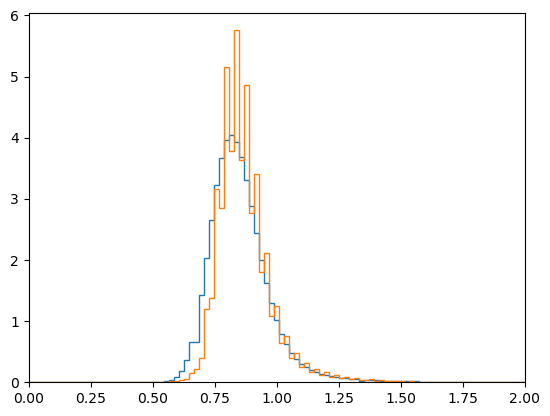

In [242]:
plt.hist(pip.flatten(), bins=np.linspace(0,2,100), histtype='step', density=True)
plt.hist(geminin.flatten(), bins=np.linspace(0,2,100), histtype='step', density=True)

plt.xlim(0,2)

In [243]:
pip[0].shape

(1586, 1125)

In [69]:
img_shape=np.array(pip[0].shape)
model_shape=16*(img_shape//16)

padding=((img_shape-model_shape)/2).astype('int')

y_slice=slice(padding[0], padding[0]+model_shape[0])
x_slice=slice(padding[1], padding[1]+model_shape[1])

In [73]:
full_ae=AutoEncoder((*model_shape, 1))
full_ae.load_weights('FUCCI_denoise/checkpoints/0303-skip_CNN-207-0.0078.hdf5')

In [131]:
prediction=full_ae.predict(pip[:,y_slice,x_slice,np.newaxis], batch_size=1)

152/152 [==============================] - 53s 321ms/step


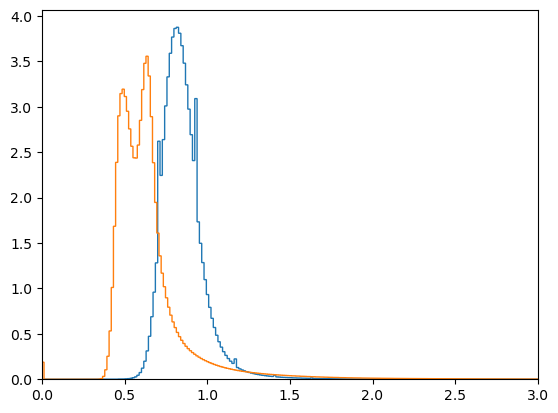

In [244]:
plt.hist(pip.flatten(), histtype='step', bins=1000, density=True)
plt.hist(prediction.flatten(), histtype='step', bins=1000, density=True)
plt.xlim(0,3)
plt.show()

In [250]:
repadding=np.array([padding, img_shape-(model_shape+padding)]).T
padded_prediction=np.pad(prediction, ((0,0),*repadding,(0,0)), mode='edge')

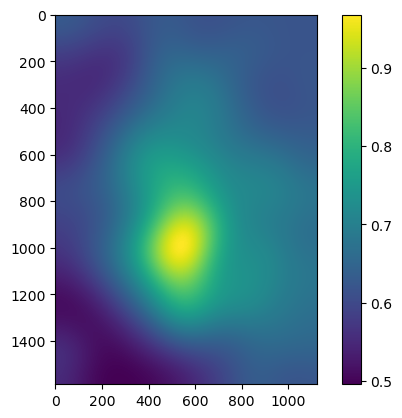

In [267]:
bg=ndimage.gaussian_filter(padded_prediction.mean(axis=0), sigma=100, truncate=3)
subtracted=padded_prediction-bg
plt.imshow(bg)
plt.colorbar()

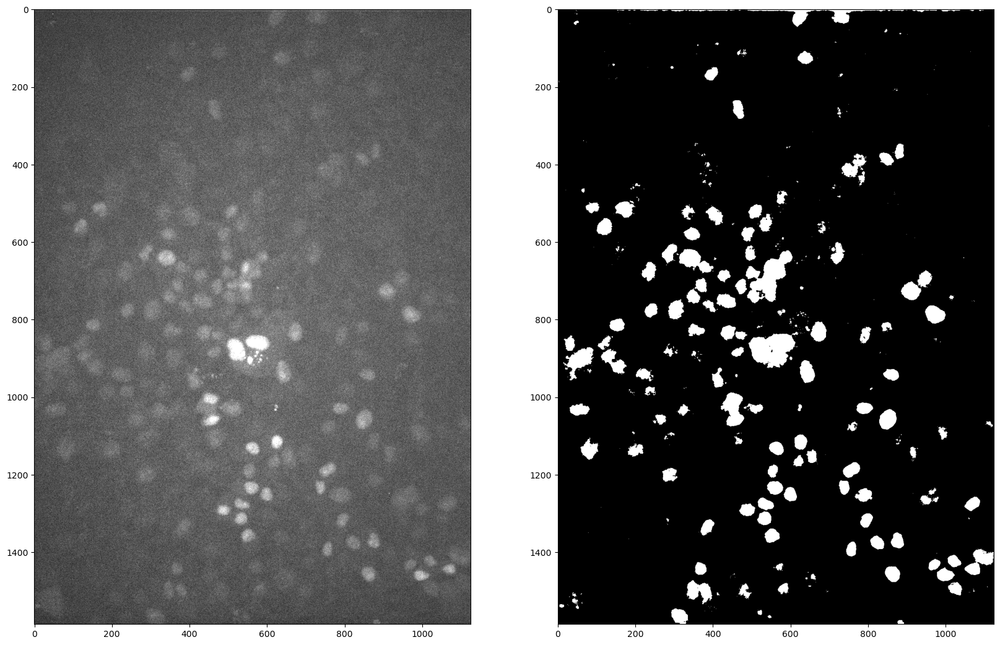

In [274]:
fig, axes=plt.subplots(1,2,figsize=(20,14))
axes[0].imshow(pip[0], vmin=0.5, vmax=1.5, cmap='gray')
axes[1].imshow(subtracted[0]>0.19, cmap='gray')

In [269]:
np.quantile(subtracted, (0.01,0.99))

array([-0.30521989,  1.13949108])

In [270]:
from scipy import ndimage
from tqdm import tqdm

nuclei=[]
threshold=0.1 # is overwritten
size_threshold=300 # scale to, say, 0.5 cell size?
img=subtracted[0]
for threshold in tqdm(np.linspace(*np.quantile(img, (0.01,0.99)), 50)):
    labels, n_features=ndimage.label(img>threshold)
    n_nuclei=np.sum(np.unique(labels, return_counts=True)[1][1:]>size_threshold)
    nuclei.append(n_nuclei-0.02*n_features)

  0%|          | 0/51 [00:00<?, ?it/s]

100%|██████████| 51/51 [00:01<00:00, 40.51it/s]


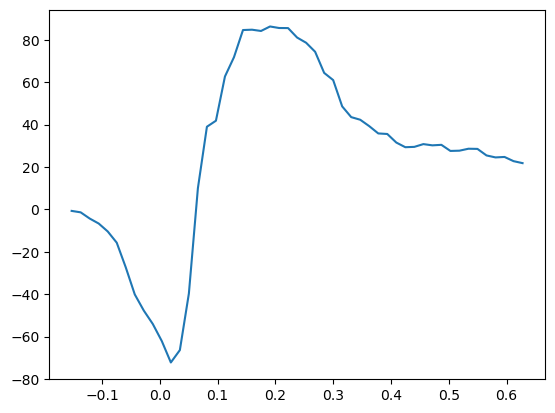

In [272]:
plt.plot(np.linspace(*np.quantile(img, (0.01,0.99)), 51), nuclei)

In [273]:
np.linspace(*np.quantile(img, (0.01,0.99)), 51)[np.argmax(nuclei)]

0.19086532914638527

## load denoised from tif

In [2]:
stack=Stack('F:/my_data/Segmentation/20240322 FUCCI halo sort1 col_glass colonies/segmented/')

In [9]:
pip_denoised=io.imread(r'F:\my_data\Data\20240322 FUCCI halo sort1 col_glass colonies\PIP-denoised.tif')
geminin_denoised=io.imread(r'F:\my_data\Data\20240322 FUCCI halo sort1 col_glass colonies\geminin-denoised.tif')

In [6]:
stack.frames[0].masks.shape

(3099, 3252)

In [10]:
for frame, pip, geminin in zip(tqdm(stack.frames), pip_denoised, geminin_denoised):
    frame.FUCCI=np.array([geminin, pip])
    frame.to_seg_npy()

  0%|          | 0/116 [00:00<?, ?it/s]

# demo denoise

In [11]:
X=io.imread(r'F:\my_data\Data\20240316 FUCCI halo training\blurred\X.tif').astype(float)
y=io.imread(r'F:\my_data\Data\20240316 FUCCI halo training\blurred\y.tif').astype(float)

for img_channel in [X, y]:
    for color_channel in range(2):
        img_channel[:,color_channel]=img_channel[:,color_channel]/np.quantile(img_channel[:,color_channel],0.99)

# determine necessary reshaping for CNN input
img_shape=np.array(X.shape[-2:])
model_shape=16*(img_shape//16)

padding=((img_shape-model_shape)/2).astype('int')

y_slice=slice(padding[0], padding[0]+model_shape[0])
x_slice=slice(padding[1], padding[1]+model_shape[1])

# initialize CNN autoencoder
full_UNet=UNet((*model_shape, 1), filters=32)
full_UNet.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240326\tile256-047-0.0039.hdf5')

geminin, pip=X[:,0], X[:,1]

output=[]
for img_channel in [geminin, pip]:
    # ae denoise
    prediction=full_UNet.predict(img_channel[:,y_slice,x_slice,np.newaxis], batch_size=1)
    
    repadding=np.array([padding, img_shape-(model_shape+padding)]).T
    output.append(np.pad(prediction[...,0], ((0,0),*repadding), mode='edge'))

pip_predict, geminin_predict=output

In [9]:
img_channel.shape

(211, 2, 1586)

In [10]:
X.shape

(211, 2, 1586, 1125)

In [12]:
geminin, pip=X[:,0], X[:,1]

output=[]
for img_channel in [geminin, pip]:
    # ae denoise
    prediction=full_UNet.predict(img_channel[:,y_slice,x_slice,np.newaxis], batch_size=1)
    
    repadding=np.array([padding, img_shape-(model_shape+padding)]).T
    output.append(np.pad(prediction[...,0], ((0,0),*repadding), mode='edge'))

pip_predict, geminin_predict=output

211/211 [==============================] - 52s 248ms/step


In [14]:
pip_predict.shape

(211, 1586, 1125)

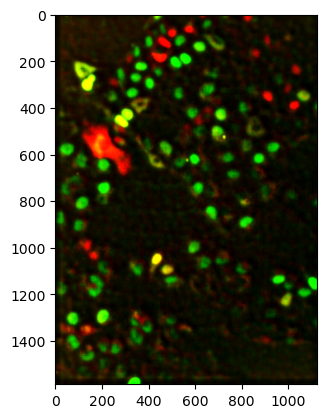

In [20]:
frame_number=20
color_FUCCI=np.stack([geminin_predict[frame_number], pip_predict[frame_number], np.zeros_like(pip_predict[0])], axis=-1)

plt.imshow(preprocessing.normalize(color_FUCCI, quantile=(0.01,0.99)))

In [32]:
test_img=io.imread(r"F:\my_data\Data\20240310 FUCCI halo sorted col_glass low_density\geminin-stage_2.tif")
test_img=test_img/np.quantile(test_img,0.99)

prediction=full_ae.predict(test_img[:,y_slice,x_slice,np.newaxis], batch_size=1)

repadding=np.array([padding, img_shape-(model_shape+padding)]).T
prediction=np.pad(prediction[...,0], ((0,0),*repadding), mode='edge')

122/122 [==============================] - 42s 343ms/step


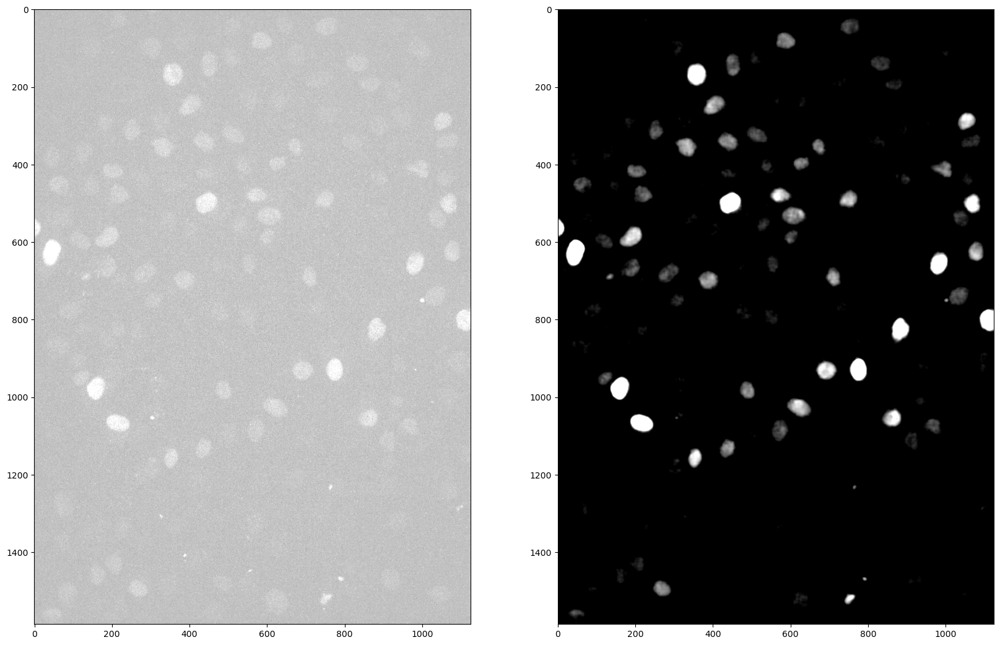

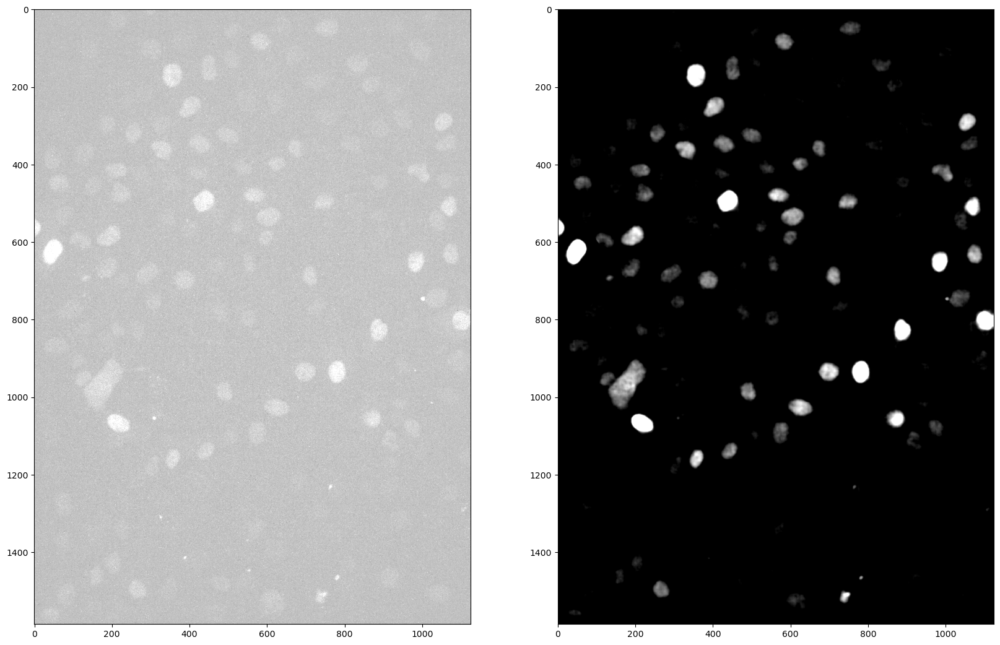

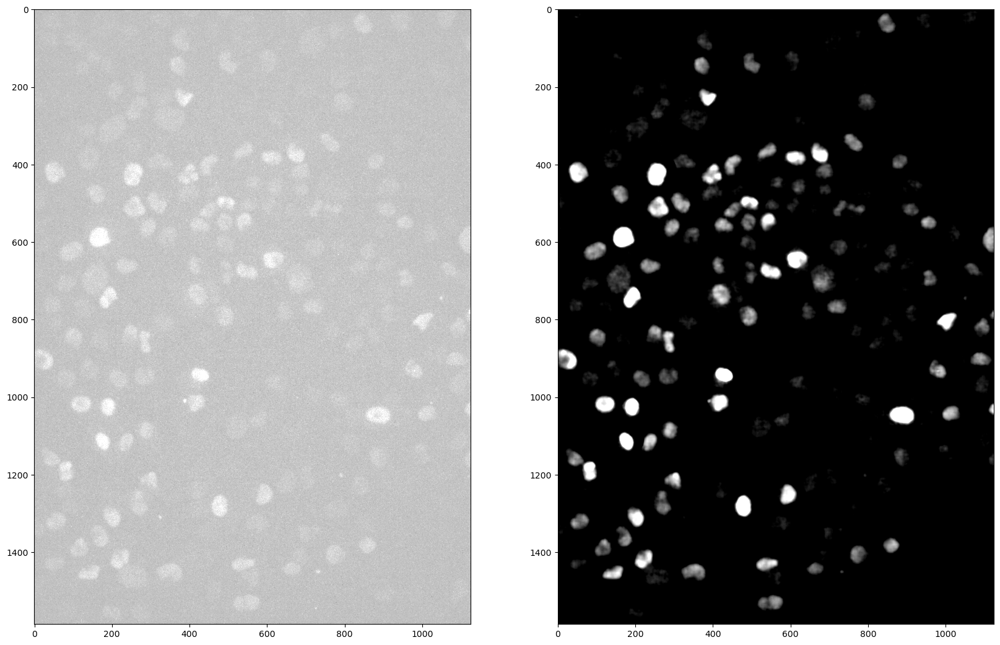

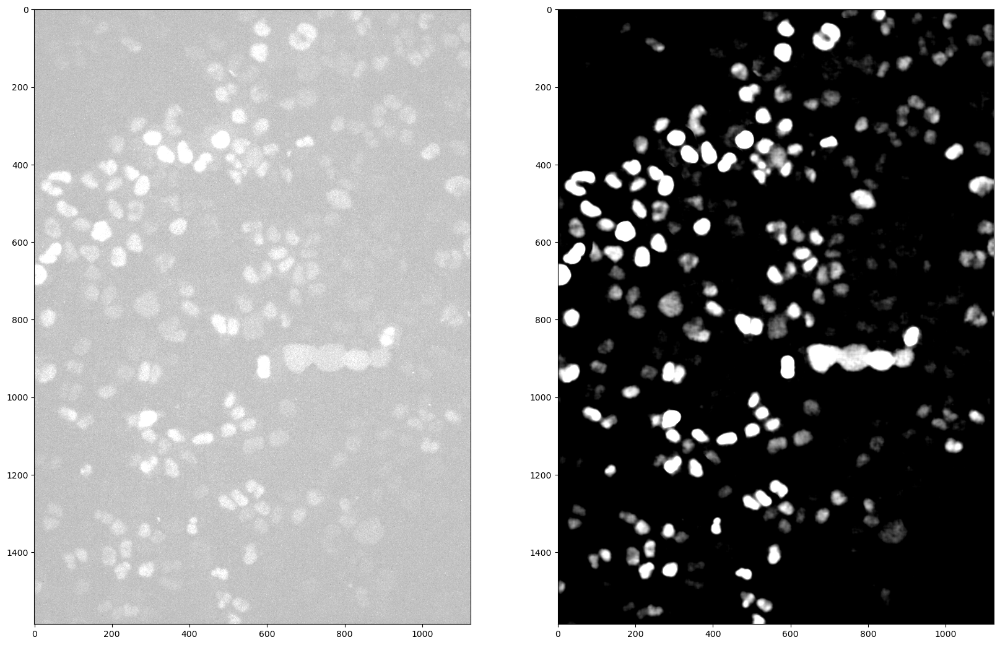

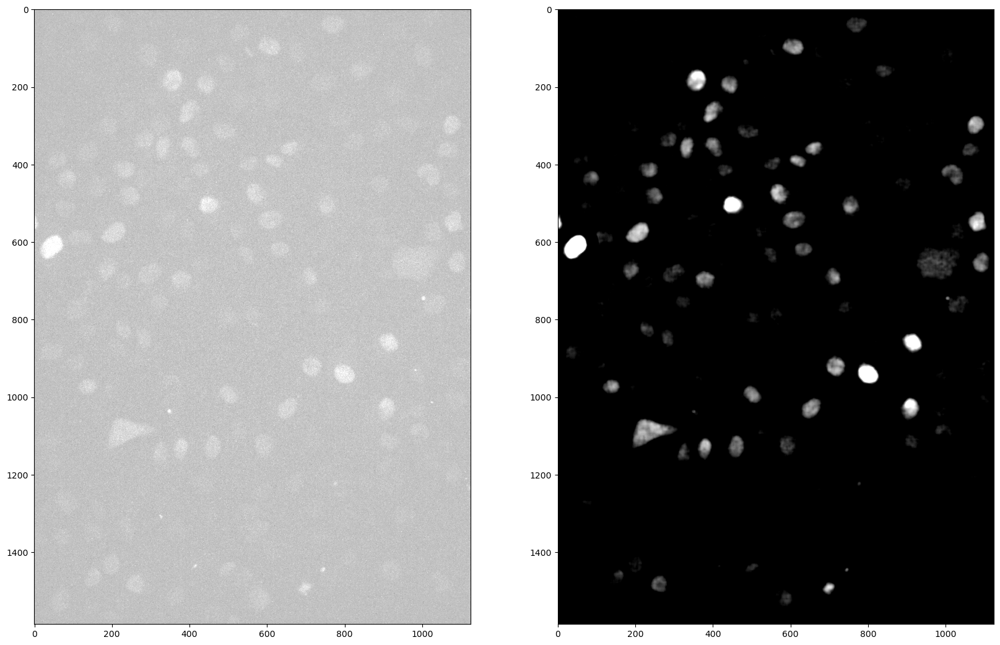

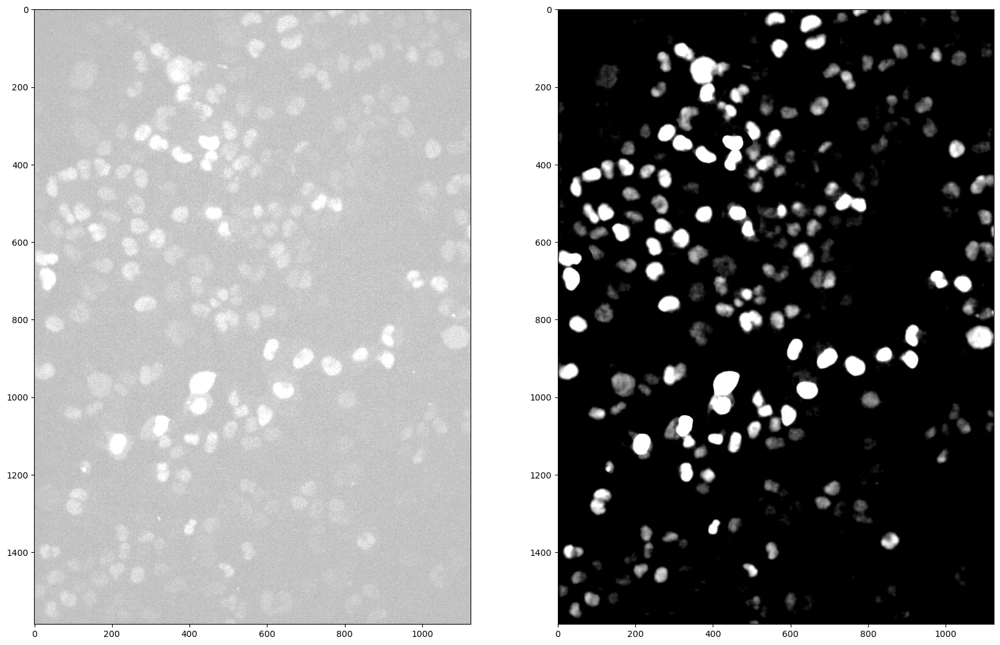

In [34]:
n_samples=6
random_indices=np.random.choice(range(len(prediction)), n_samples, replace=False)

for index in random_indices:
    fig, axes=plt.subplots(1,2, figsize=(20,14))
    axes[0].imshow(test_img[index], cmap='gray', vmin=0,vmax=1)
    axes[1].imshow(prediction[index], cmap='gray', vmin=0,vmax=1)
    plt.show()

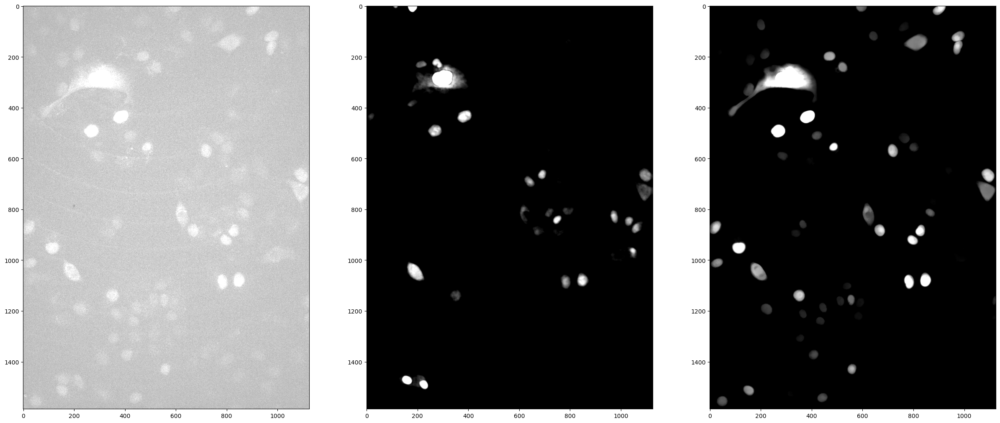

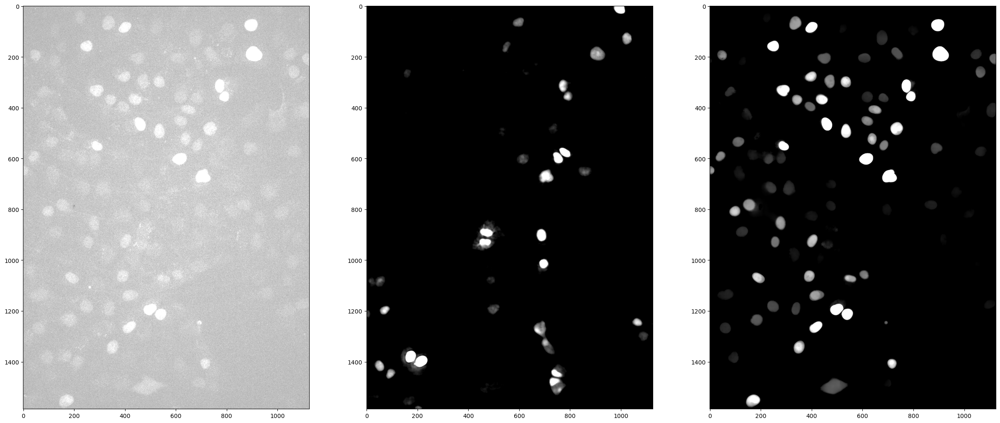

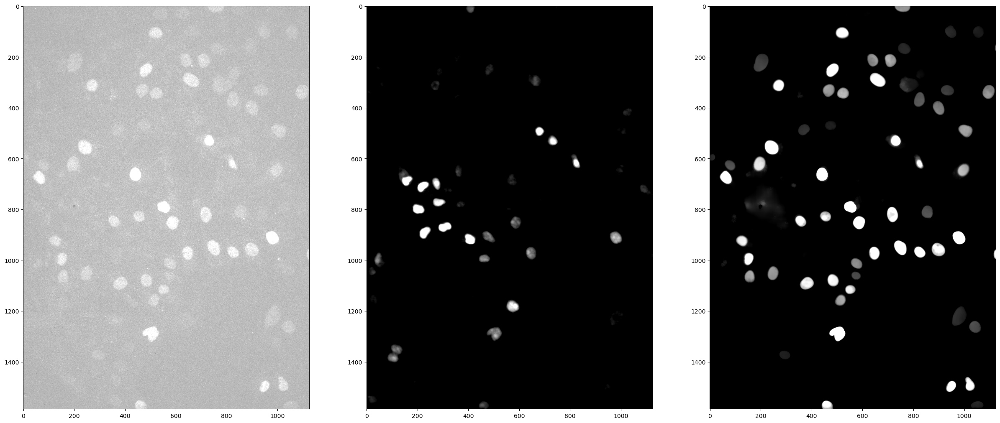

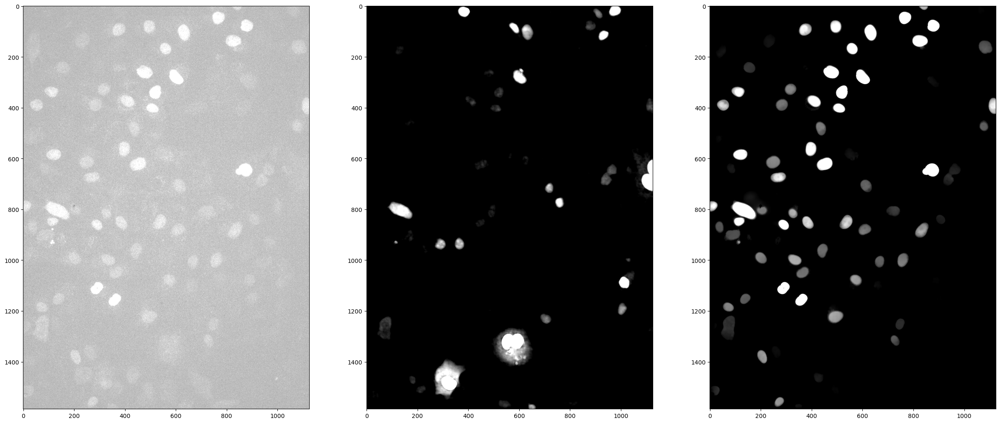

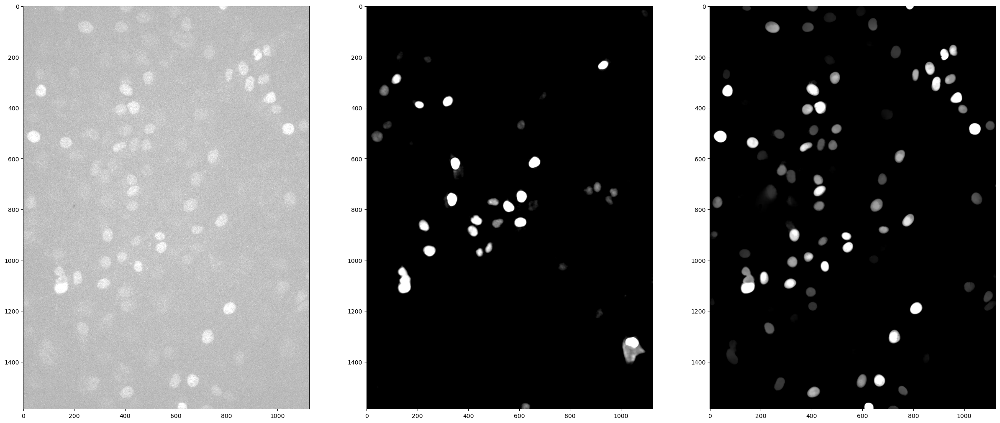

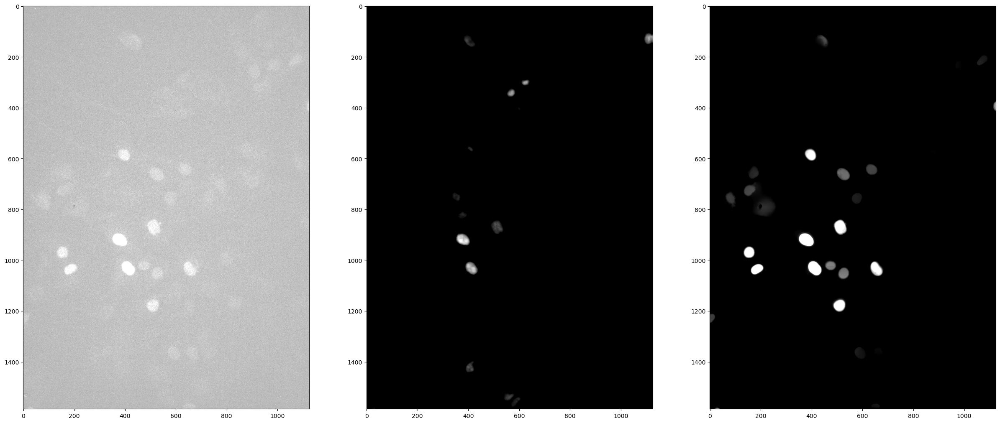

In [24]:
n_samples=6
random_indices=np.random.choice(range(len(geminin)), n_samples, replace=False)

for index in random_indices:
    fig, axes=plt.subplots(1,3, figsize=(30,14))
    axes[0].imshow(geminin[index], cmap='gray', vmin=0,vmax=1)
    axes[2].imshow(geminin_y[index], cmap='gray', vmin=0,vmax=1)
    axes[1].imshow(geminin_predict[index], cmap='gray', vmin=0,vmax=1)
    plt.show()

# tiling and stitching

In [3]:
# break images into 512x512 overlapping patches
def pad_to_shape(img, shape):
    # pad bottom and right to the desired shape
    y_pad=shape[0]-img.shape[0]
    x_pad=shape[1]-img.shape[1]
    return np.pad(img, ((0,y_pad),(0,x_pad)), mode='edge')

def get_tiles(img, tile_size=512):
    y_blocks, x_blocks=np.array(img.shape[-2:])//tile_size+1

    # compute overlap size
    overlap_y, overlap_x=(tile_size-(np.array(img.shape[-2:])%tile_size))//[y_blocks-1, x_blocks-1]
    # get tiles
    tiles=[]
    for y in range(y_blocks):
        for x in range(x_blocks):
            y_start=y*(tile_size-overlap_y)
            y_end=y_start+tile_size
            x_start=x*(tile_size-overlap_x)
            x_end=x_start+tile_size
            tiles.append(pad_to_shape(img[y_start:y_end, x_start:x_end], (tile_size, tile_size)))
    return np.array(tiles)

def stitch_tiles(tiles, output_shape):
    # get number of rows and columns
    tile_size=tiles.shape[-1]
    rows, cols=np.array(output_shape)//tile_size+1

    # initialize output array
    output=np.zeros((rows*tile_size, cols*tile_size))

    # compute overlap size
    overlap_y, overlap_x=(tile_size-(np.array(output_shape)%tile_size))//[rows-1, cols-1]

    # stitch tiles with feathered averaging of overlaps
    for y in range(rows):
        for x in range(cols):
            y_start=y*(tile_size-overlap_y)
            y_end=y_start+tile_size
            x_start=x*(tile_size-overlap_x)
            x_end=x_start+tile_size
            output[y_start:y_end, x_start:x_end]+=tiles[y*cols+x]
    
    for x in range(1,cols):
        x_start=x*(tile_size-overlap_x)
        x_end=x_start+overlap_x
        output[:,x_start:x_end]/=2

    for y in range(1,rows):
        y_start=y*(tile_size-overlap_y)
        y_end=y_start+overlap_y
        output[y_start:y_end,:]/=2
    
    return output[0:output_shape[0], 0:output_shape[1]]

In [4]:
pip, geminin, pip_y, geminin_y=[io.imread(f'F:/my_data/Data/20240316 FUCCI halo training/stacks/{channel}.tif').astype(float) for channel in tqdm(['PIP_X', 'geminin_X', 'PIP_y', 'geminin_y'], desc='reading')]
for img_channel in tqdm([pip, geminin, pip_y, geminin_y], desc='normalizing'):
    img_channel[:]=img_channel/np.quantile(img_channel,0.99)

reading:   0%|          | 0/4 [00:00<?, ?it/s]

normalizating:   0%|          | 0/4 [00:00<?, ?it/s]

In [5]:
img_shape=pip[0].shape
tile_size=256
rows, cols=np.array(img_shape[-2:])//tile_size+1

# get tiled images
pip_tiles=np.array([get_tiles(img, tile_size) for img in pip]).reshape(-1,tile_size,tile_size,1)
pip_y_tiles=np.array([get_tiles(img, tile_size) for img in pip_y]).reshape(-1,tile_size,tile_size,1)
#geminin_tiles=np.array([get_tiles(img, tile_size) for img in geminin]).reshape(-1,tile_size,tile_size,1)

# initialize CNN autoencoder
full_ae=AutoEncoder((tile_size,tile_size,1))
full_ae.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240317-0228_and_0316\skip_CNN256-097-0.0017.hdf5')

In [6]:
pip_predict=full_ae.predict(pip_tiles, batch_size=4)

1847/1847 [==============================] - 102s 53ms/step


In [7]:
full_ae.compile(optimizer='adam', loss='mse')

In [8]:
full_ae.evaluate(pip_tiles, pip_y_tiles, batch_size=4)

1847/1847 [==============================] - 97s 52ms/step - loss: 0.0601


0.06006426736712456

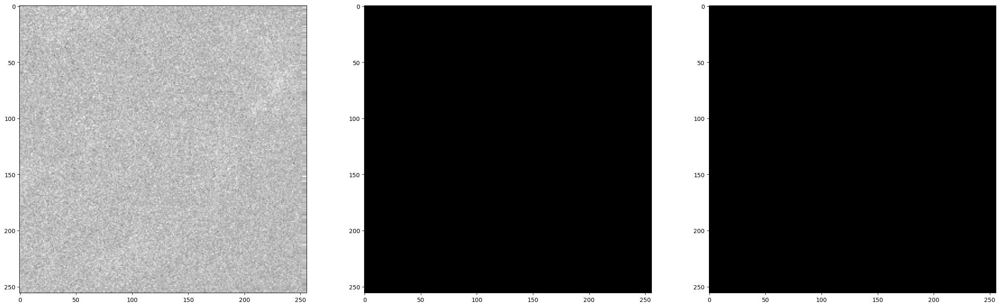

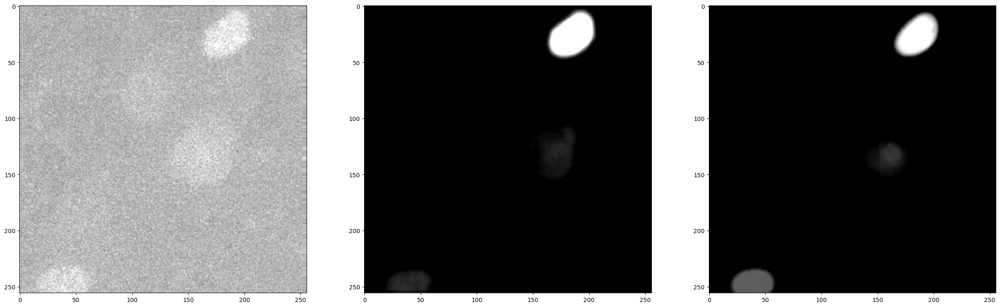

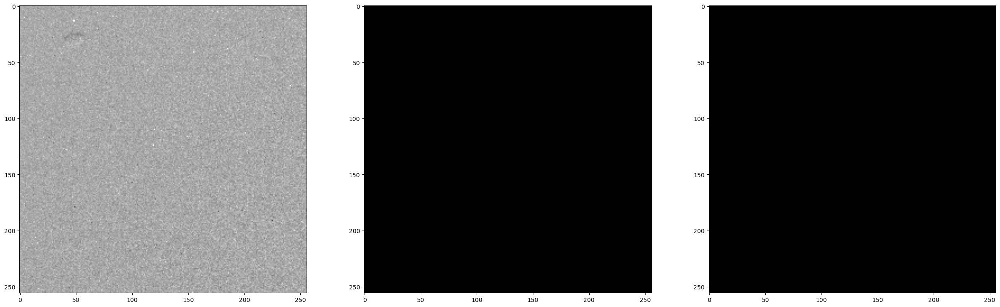

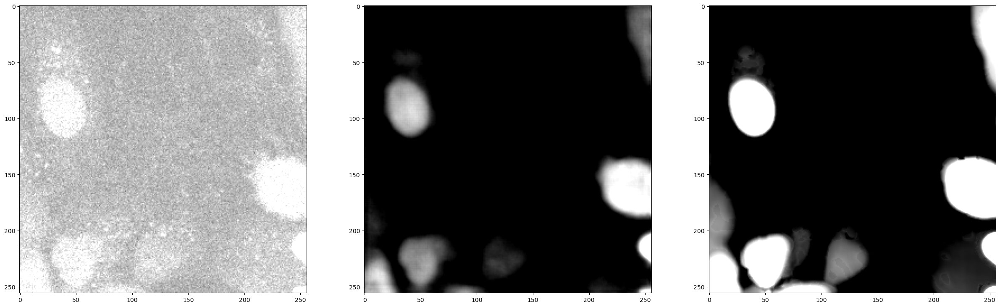

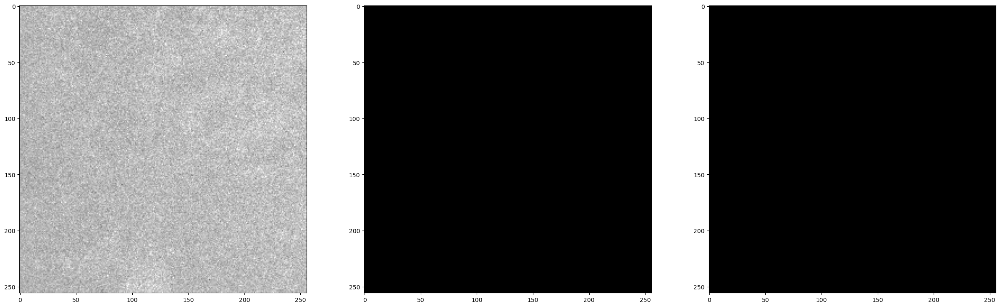

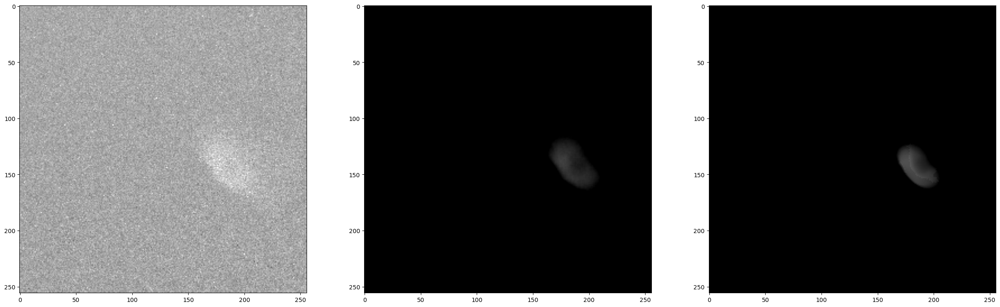

In [9]:
# plot predictions next to pip_y
n_samples=6
random_indices=np.random.choice(range(len(pip_predict)), n_samples, replace=False)

for index in random_indices:
    fig, axes=plt.subplots(1,3, figsize=(30,14))
    axes[0].imshow(pip_tiles[index,...,0], cmap='gray', vmin=0,vmax=1)
    axes[1].imshow(pip_predict[index,...,0], cmap='gray', vmin=0,vmax=1)
    axes[2].imshow(pip_y_tiles[index,...,0], cmap='gray', vmin=0,vmax=1)
    plt.show()

In [11]:
pip_stitched=np.array([stitch_tiles(tiles, pip[0].shape) for tiles in tqdm(pip_predict.reshape(-1,rows*cols,tile_size,tile_size))])

  0%|          | 0/211 [00:00<?, ?it/s]

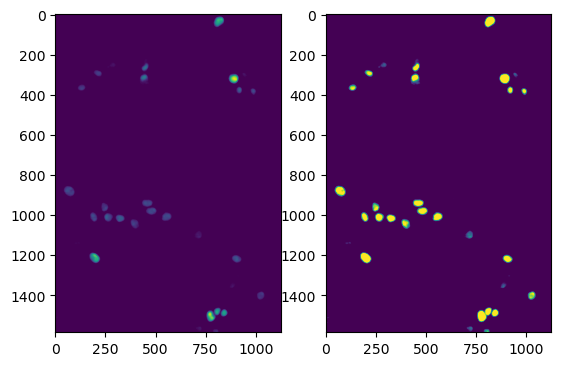

In [15]:
fig, axes=plt.subplots(1,2)
axes[0].imshow(pip_stitched[0])
axes[1].imshow(preprocessing.normalize(pip_stitched[0], quantile=(0.01,0.99)))

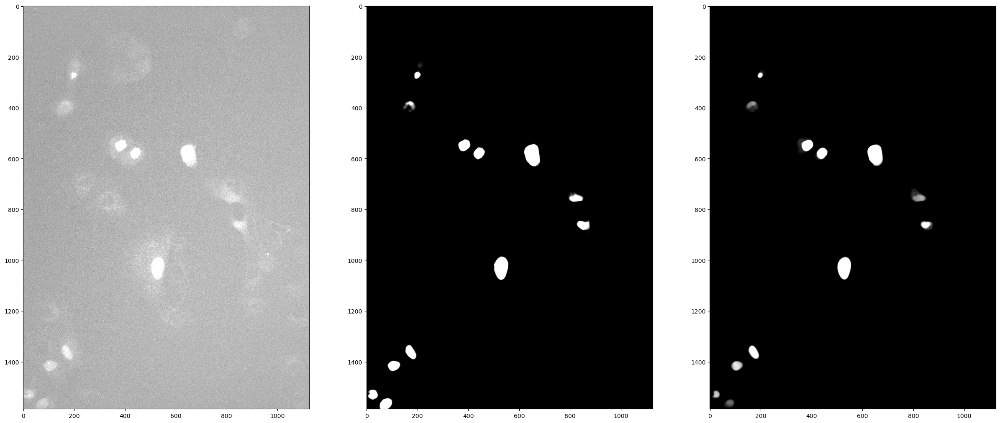

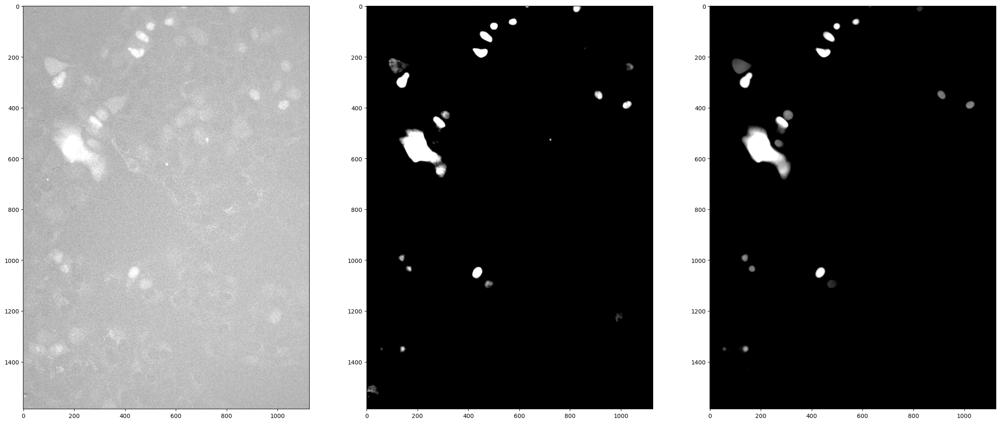

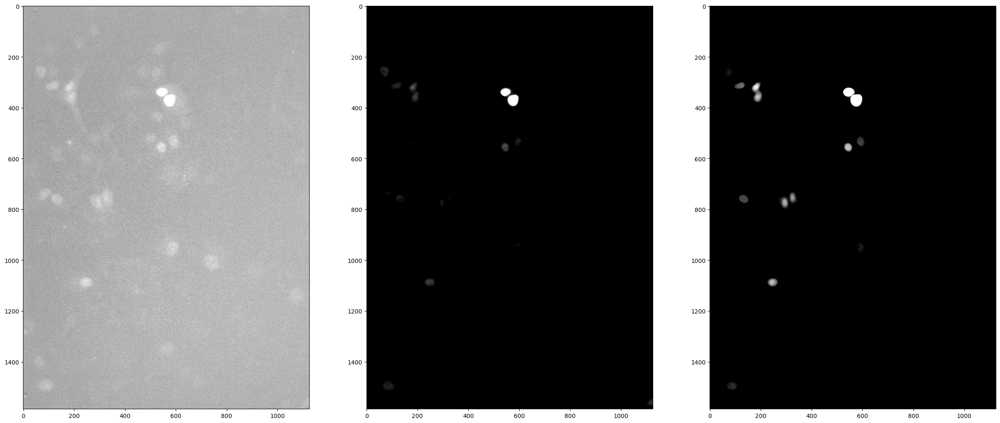

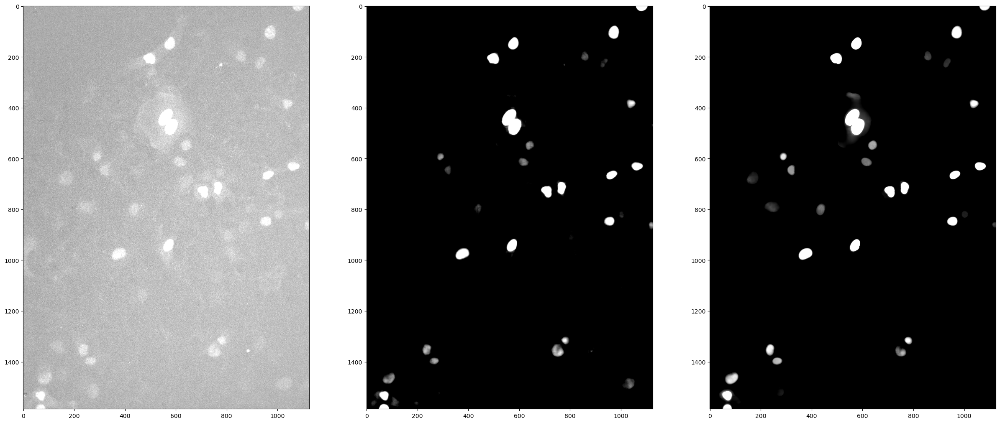

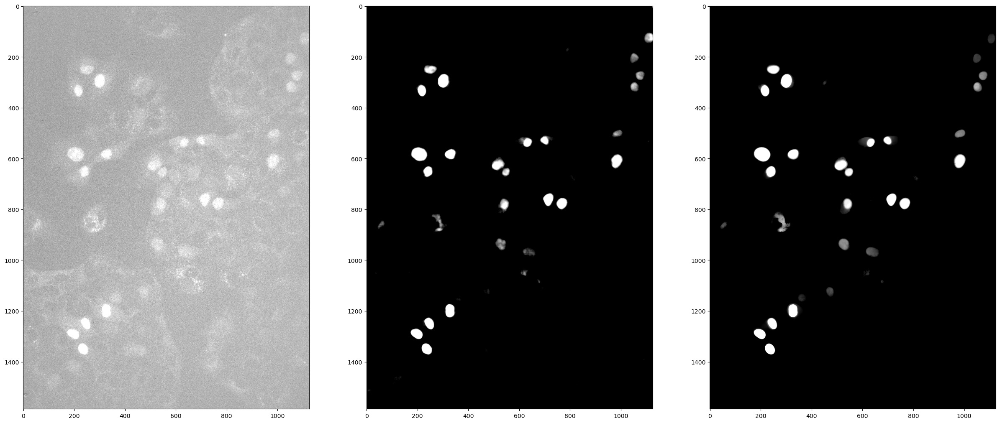

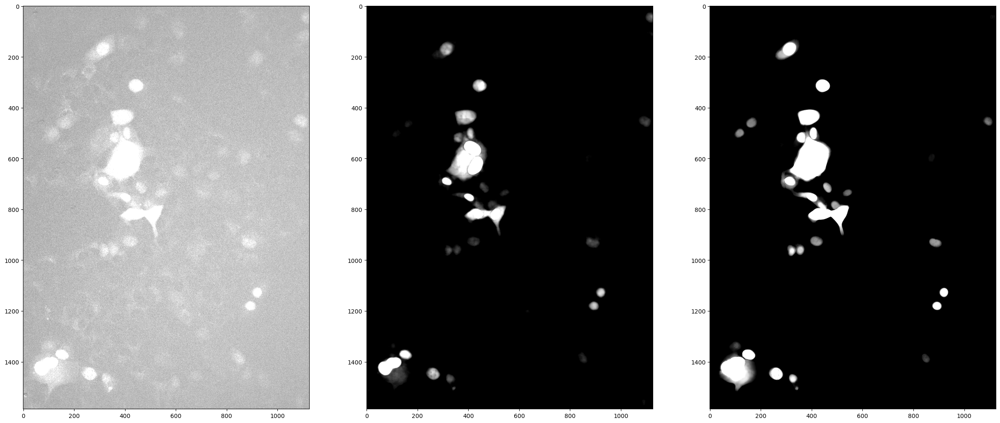

In [16]:
random_indices=np.random.choice(range(len(pip_stitched)), 6, replace=False)

for index in random_indices:
    fig,axes=plt.subplots(1,3,figsize=(30,14))
    axes[0].imshow(pip[index], cmap='gray', vmin=0, vmax=1)
    axes[1].imshow(preprocessing.normalize(pip_stitched[index], quantile=(0.01,0.99)), cmap='gray', vmin=0, vmax=1)
    axes[2].imshow(pip_y[index], cmap='gray', vmin=0, vmax=1)